## Cycle GAN - Style Transfer
#### DTSA 5511 - Kaggle Mini Project: I’m Something of a Painter Myself

## 1. Problem Description and Dataset
The task in this Kaggle project is to build a GAN capable of generating 7,000 to 10,000 Monet-style images. We are provided with two sets of images: 300 Monet painting images and 7,038 photo images. They are of size 256x256x3 and in JPEG format. Given the imbalance in the sizes of these two image sets, with only 300 Monet painting images compared to 7,038 photo images, it may not be feasible to exhaustively utilize all the images from the larger set in each epoch. Nevertheless, over multiple epochs, different subsets of the photo dataset will be used for training, providing a diverse set of training examples for the model to learn from.

Kaggle evaluates submissions based on MiFID (Memorization-informed Fréchet Inception Distance), a modified version of Fréchet Inception Distance (FID). MiFID is a metric used to evaluate the performance of generative models. It measures the similarity between the distribution of generated images and that of real images based on the features extracted from a pre-trained neural network, typically InceptionV3. The lower the MiFID score, the higher the quality of our generated images.

To accomplish this task, I will construct a generative model based on the paper [*Unpaired Image-to-Image Translation using Cycle-Consistent Adversarial Networks*](https://arxiv.org/abs/1703.10593) by Zhu et al. 2017, commonly referred to as CycleGAN. It will largely follow their CycleGAN framework, utilizing their established hyperparameters. The code will largely follow the Generative Adversarial Networks (GANs) Specialization Course from Deep Learning AI by Sharon Zhou.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import glob
import random
import os

import torch
import torchvision
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader
from PIL import Image

## 2. Exploratory Data Analysis

In [2]:
monet_path = glob.glob('monet_jpg/*.jpg') 
photo_path = glob.glob('photo_jpg/*.jpg')
print('Number of Monet images:', len(monet_path))
print('Number of Photo images:', len(photo_path))
print('Monet image shape:', plt.imread(monet_path[0]).shape)
print('Photo image shape:', plt.imread(photo_path[0]).shape)

Number of Monet images: 300
Number of Photo images: 7038
Monet image shape: (256, 256, 3)
Photo image shape: (256, 256, 3)


In [3]:
def plot_images(imgs, title):
    indices = np.random.choice(len(imgs), 16)
    plt.figure(figsize=(12, 5))
    plt.suptitle(title, y=0.85, fontsize=14)
    for i, index in enumerate(indices):
        plt.subplot(2, 8, i+1)
        plt.imshow(plt.imread(imgs[index]))
        plt.axis('off')
    plt.tight_layout()

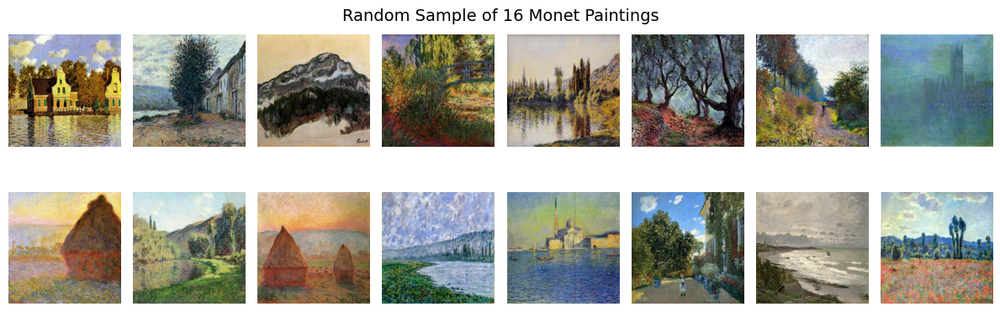

In [4]:
plot_images(monet_path, 'Random Sample of 16 Monet Paintings')

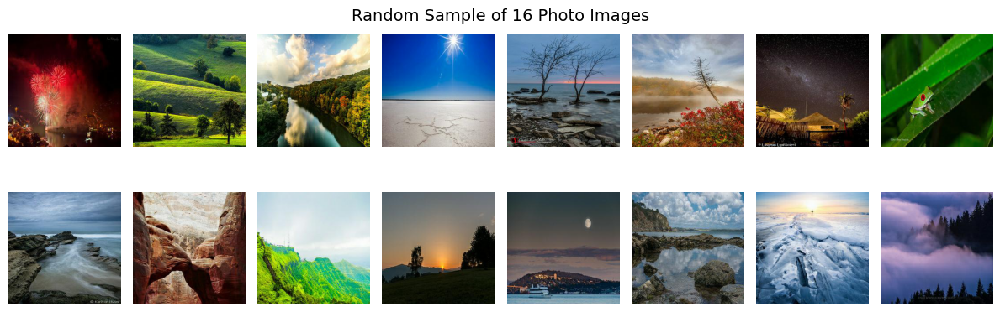

In [6]:
plot_images(photo_path, 'Random Sample of 16 Photo Images')

### Data Augmentation
Data augmentation for GANs should be done carefully. If we apply transformations that can change too much the style of the data (e.g. brightness, contrast, saturation) it can cause the generator to not efficiently learn the base style, so in this case, we are using only spatial transformations like flips and crops. (Later on, I experimented with adding slight random changes in brightness, contrast, saturation and hue. However, these adjustments did not have a visually noticeable effect on the end result)

In [10]:
load_shape = 286
target_shape = 256

# transform = transforms.Compose([
#     transforms.Resize((256, 256)),
#     transforms.ToTensor(),
#     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
# ])

transform = transforms.Compose([
    transforms.Resize(load_shape),
    transforms.RandomCrop(target_shape),
    transforms.RandomHorizontalFlip(p=0.5),
    #transforms.ColorJitter(brightness=0.05, contrast=0.05, saturation=0.05, hue=0.05),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

In [4]:
def show_tensor_images(image_tensor, num_images=8, size=(3, 256, 256), title='Real'):    # image_tensor: torch.cat([real_A, real_B])
    '''
    Function for visualizing images during training
    '''
    titles = '4 ' + title + ' Monet; 4 ' + title + ' Photo'
    
    # Ensure pixel values are within the valid range [0, 1]
    image_tensor = torch.clamp((image_tensor + 1) / 2, 0, 1)
    image_unflat = image_tensor.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow=4)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.title(titles)
    plt.axis('off')
    plt.show()

In [5]:
# A -> Monet
# B -> Photo
class ImageDataset(Dataset):
    def __init__(self, monet_path, photo_path, transform=None):
        self.transform = transform
        self.files_A = sorted(monet_path)    # 300 monet images
        self.files_B = sorted(photo_path)    # 7038 photo images
        self.new_perm()

    def new_perm(self):
        self.randperm = torch.randperm(len(self.files_B))[:len(self.files_A)]     # torch.randperm(7038)[:300]

    def __getitem__(self, index):
        item_A = self.transform(Image.open(self.files_A[index % len(self.files_A)]))
        item_B = self.transform(Image.open(self.files_B[self.randperm[index]]))
        if item_A.shape[0] != 3: 
            item_A = item_A.repeat(3, 1, 1)
        if item_B.shape[0] != 3: 
            item_B = item_B.repeat(3, 1, 1)
        if index == len(self) - 1:
            self.new_perm()
        return item_A, item_B

    def __len__(self):
        return min(len(self.files_A), len(self.files_B))

We can now load the images of the dataset while introducing some data augmentation. 

In [6]:
dataset = ImageDataset(monet_path, photo_path, transform=transform)

## 3. Model Architecture
CycleGAN achieves unpaired image translation by simultaneously training two generator networks and two discriminator networks, with the introduction of cycle consistency loss to enforce one-to-one correspondence mappings between the domains. 

The generators aim to translate images from domain A to domain B and vice versa, while the discriminators aim to distinguish between translated images and real images from their respective domains. During training, the generators aim to minimize both the adversarial loss (fooling the discriminators) and the cycle consistency loss (ensuring one-to-one correspondence mappings). Meanwhile, the discriminators aim to distinguish between real and translated images. This adversarial training process continues iteratively until satisfactory level of performance is achieved.

Hyperparameter settings (largely follow the original CycleGAN paper):
* Adversarial loss: MSE
* Cycle Consistency loss: L1
* Weight of the cycle-consistency loss (lambda): 10
* Learning rate: 0.0002 (The CycleGAN authors set this learning for the first 100 epochs and linearly decay the rate to zero over the next 100 epochs, however we will only train for a maximum of 100 epochs)
* Adam solver with a batch size of 4 (The authors set the batch size to 1), and betas are set to (0.5, 0.999)
* Reflection padding (padding_mode='reflect') in all conv2d layers: this is to reduce artifacts according to the paper
* ReLU activation for the generator
* Leaky ReLU activation with a slope of 0.2 for the discriminator

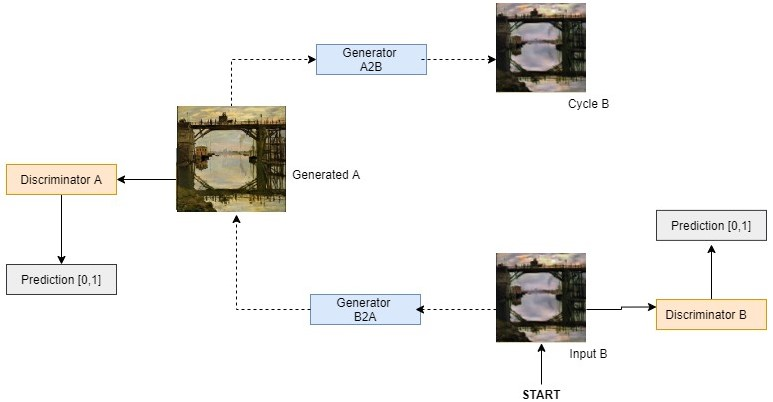

## Generator

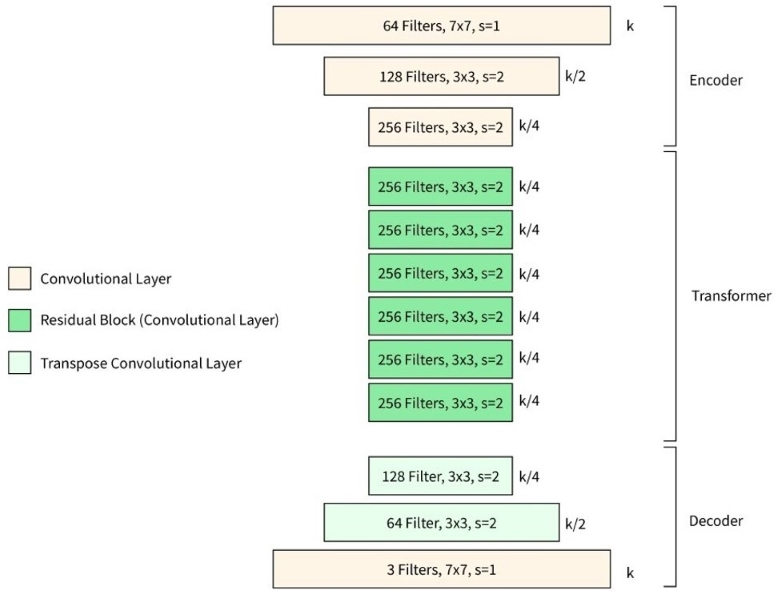

*Diagram of a CycleGAN generator: composed of encoder, transformer (Residual Block), and then decoder.*

#### Residual Block
In CycleGAN, after the expanding blocks, there are convolutional layers where the output is added to the original input. This design ensures that the network alters the image as minimally as possible. This transformation can be conceptualized as a form of skip connection. Unlike traditional concatenation of channels before convolution, here the additional information is directly added to the output of the convolutional layer. 

The skip connections facilitate deeper networks by addressing the issue of vanishing gradients. In deep neural networks, gradients tend to diminish during backpropagation, making learning difficult. However, with skip connections, gradient flow is enhanced, mitigating the vanishing gradients problem.

Instance normalization is applied in the residual block. For each sample (or instance) in the batch, instance normalization calculates the mean and standard deviation separately for each channel of the feature map.

In [11]:
class ResidualBlock(nn.Module):
    '''
    Performs two convolutions and an instance normalization, the input is added
    to this output to form the residual block output.
    '''
    def __init__(self, input_channels):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(input_channels, input_channels, kernel_size=3, padding=1, padding_mode='reflect')
        self.conv2 = nn.Conv2d(input_channels, input_channels, kernel_size=3, padding=1, padding_mode='reflect')
        self.instancenorm = nn.InstanceNorm2d(input_channels)
        self.activation = nn.ReLU()

    def forward(self, x):
        original_x = x.clone()
        x = self.conv1(x)
        x = self.instancenorm(x)
        x = self.activation(x)
        x = self.conv2(x)
        x = self.instancenorm(x)
        return original_x + x

#### Contracting Blocks (Encoder) and Expanding Blocks (Decoder)

In [12]:
class ContractingBlock(nn.Module):
    '''
    Performs a convolution followed by a max pool operation and an instance norm
    '''
    def __init__(self, input_channels, use_bn=True, kernel_size=3, activation='relu'):
        super(ContractingBlock, self).__init__()
        self.conv1 = nn.Conv2d(input_channels, input_channels * 2, kernel_size=kernel_size, padding=1, stride=2, padding_mode='reflect')
        self.activation = nn.ReLU() if activation == 'relu' else nn.LeakyReLU(0.2)
        if use_bn:
            self.instancenorm = nn.InstanceNorm2d(input_channels * 2)
        self.use_bn = use_bn

    def forward(self, x):
        '''
        x: image tensor of shape (batch size, channels, height, width)
        '''
        x = self.conv1(x)
        if self.use_bn:
            x = self.instancenorm(x)
        x = self.activation(x)
        return x

class ExpandingBlock(nn.Module):
    '''
    Performs a convolutional transpose operation in order to upsample
    '''
    def __init__(self, input_channels, use_bn=True):
        super(ExpandingBlock, self).__init__()
        self.conv1 = nn.ConvTranspose2d(input_channels, input_channels // 2, kernel_size=3, stride=2, padding=1, output_padding=1)
        if use_bn:
            self.instancenorm = nn.InstanceNorm2d(input_channels // 2)
        self.use_bn = use_bn
        self.activation = nn.ReLU()

    def forward(self, x):
        x = self.conv1(x)
        if self.use_bn:
            x = self.instancenorm(x)
        x = self.activation(x)
        return x

class FeatureMapBlock(nn.Module):
    '''
    The final layer of a Generator - maps each the output to the desired number of output channels
    '''
    def __init__(self, input_channels, output_channels):
        super(FeatureMapBlock, self).__init__()
        self.conv = nn.Conv2d(input_channels, output_channels, kernel_size=7, padding=3, padding_mode='reflect')

    def forward(self, x):
        x = self.conv(x)
        return x

#### CycleGAN Generator
Putting all the blocks together.

In [13]:
class Generator(nn.Module):
    '''
    2 contracting blocks, 9 residual blocks, and 2 expanding blocks,
    with an up feature layer at the start and a downfeature layer at the end
    '''
    def __init__(self, input_channels, output_channels, hidden_channels=64):
        super(Generator, self).__init__()
        self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
        self.contract1 = ContractingBlock(hidden_channels)
        self.contract2 = ContractingBlock(hidden_channels * 2)
        res_mult = 4
        self.res0 = ResidualBlock(hidden_channels * res_mult)
        self.res1 = ResidualBlock(hidden_channels * res_mult)
        self.res2 = ResidualBlock(hidden_channels * res_mult)
        self.res3 = ResidualBlock(hidden_channels * res_mult)
        self.res4 = ResidualBlock(hidden_channels * res_mult)
        self.res5 = ResidualBlock(hidden_channels * res_mult)
        self.res6 = ResidualBlock(hidden_channels * res_mult)
        self.res7 = ResidualBlock(hidden_channels * res_mult)
        self.res8 = ResidualBlock(hidden_channels * res_mult)
        self.expand2 = ExpandingBlock(hidden_channels * 4)
        self.expand3 = ExpandingBlock(hidden_channels * 2)
        self.downfeature = FeatureMapBlock(hidden_channels, output_channels)
        self.tanh = torch.nn.Tanh()

    def forward(self, x):
        x0 = self.upfeature(x)
        x1 = self.contract1(x0)
        x2 = self.contract2(x1)
        x3 = self.res0(x2)
        x4 = self.res1(x3)
        x5 = self.res2(x4)
        x6 = self.res3(x5)
        x7 = self.res4(x6)
        x8 = self.res5(x7)
        x9 = self.res6(x8)
        x10 = self.res7(x9)
        x11 = self.res8(x10)
        x12 = self.expand2(x11)
        x13 = self.expand3(x12)
        xn = self.downfeature(x13)
        return self.tanh(xn)

## PatchGAN Discriminator
PatchGAN discriminators classify image patches (small regions). The input to the discriminator is an image patch from either the real or generated image. By focusing on local image patches, PatchGAN discriminators can provide fine-grained feedback to the generator, guiding the generator to generate details at the patch level.

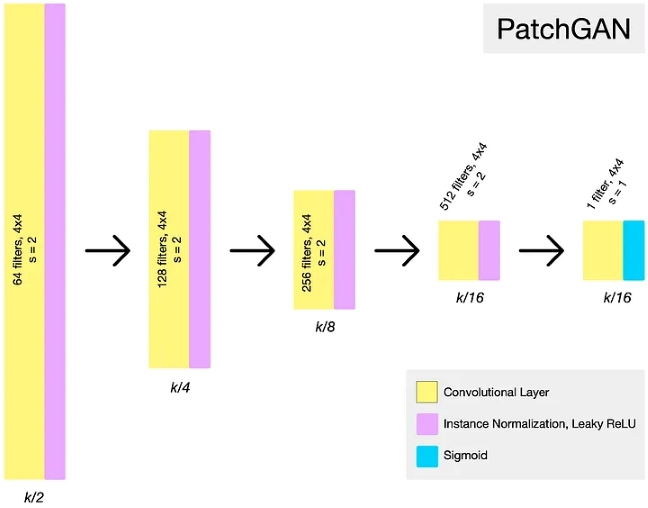

*Diagram of a PatchGAN discriminator: the PatchGAN halves the representation size and doubles the number of channels until the desired output size is reached.*

In [14]:
class Discriminator(nn.Module):
    '''
    Discriminator will output a matrix of values classifying portions of the image as real or fake
    '''
    def __init__(self, input_channels, hidden_channels=64):
        super(Discriminator, self).__init__()
        self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
        self.contract1 = ContractingBlock(hidden_channels, use_bn=False, kernel_size=4, activation='lrelu')
        self.contract2 = ContractingBlock(hidden_channels * 2, kernel_size=4, activation='lrelu')
        self.contract3 = ContractingBlock(hidden_channels * 4, kernel_size=4, activation='lrelu')
        self.final = nn.Conv2d(hidden_channels * 8, 1, kernel_size=1)

    def forward(self, x):
        x0 = self.upfeature(x)
        x1 = self.contract1(x0)
        x2 = self.contract2(x1)
        x3 = self.contract3(x2)
        xn = self.final(x3)
        return xn

Next, we can initialize our generators and discriminators:
*   Generator Monet to Photo (`gen_AB`)
*   Generator Photo to Monet (`gen_BA`)
*   Discriminator for Monet (`disc_A`)
*   Discriminator for Photo (`disc_B`)

In [15]:
def init_gen_disc(model_path='cycleGAN_100000.pth', pretrained=True):
    '''
    Initialize: generators and their optimizer: gen_AB, gen_BA, gen_opt
                discriminators and their optimizers: disc_A, disc_A_opt, disc_B, disc_B_opt
    '''
    gen_AB = Generator(dim_A, dim_B).to(device)
    gen_BA = Generator(dim_B, dim_A).to(device)
    gen_opt = torch.optim.Adam(list(gen_AB.parameters()) + list(gen_BA.parameters()), lr=lr, betas=(0.5, 0.999))
    disc_A = Discriminator(dim_A).to(device)
    disc_A_opt = torch.optim.Adam(disc_A.parameters(), lr=lr, betas=(0.5, 0.999))
    disc_B = Discriminator(dim_B).to(device)
    disc_B_opt = torch.optim.Adam(disc_B.parameters(), lr=lr, betas=(0.5, 0.999))
    
    def _weights_init(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            torch.nn.init.normal_(m.weight, 0.0, 0.02)
        if isinstance(m, nn.BatchNorm2d):
            torch.nn.init.normal_(m.weight, 0.0, 0.02)
            torch.nn.init.constant_(m.bias, 0)
    
    # change pretrained to False if training the model from scratch
    if pretrained:
        pre_dict = torch.load(model_path)
        gen_AB.load_state_dict(pre_dict['gen_AB'])
        gen_BA.load_state_dict(pre_dict['gen_BA'])
        gen_opt.load_state_dict(pre_dict['gen_opt'])
        disc_A.load_state_dict(pre_dict['disc_A'])
        disc_A_opt.load_state_dict(pre_dict['disc_A_opt'])
        disc_B.load_state_dict(pre_dict['disc_B'])
        disc_B_opt.load_state_dict(pre_dict['disc_B_opt'])
    else:
        gen_AB = gen_AB.apply(_weights_init)
        gen_BA = gen_BA.apply(_weights_init)
        disc_A = disc_A.apply(_weights_init)
        disc_B = disc_B.apply(_weights_init)

    return gen_AB, gen_BA, gen_opt, disc_A, disc_A_opt, disc_B, disc_B_opt

## Discriminator Loss

In [16]:
def get_disc_loss(real_X, fake_X, disc_X, adv_criterion):
    disc_fake_X_hat = disc_X(fake_X.detach())   # detach the generator for disc loss computation
    disc_fake_X_loss = adv_criterion(disc_fake_X_hat, torch.zeros_like(disc_fake_X_hat))
    
    disc_real_X_hat = disc_X(real_X)
    disc_real_X_loss = adv_criterion(disc_real_X_hat, torch.ones_like(disc_real_X_hat))
    
    disc_loss = (disc_fake_X_loss + disc_real_X_loss) / 2

    return disc_loss

## Generator Loss

#### Adversarial Loss

In [17]:
def get_gen_adversarial_loss(real_X, disc_Y, gen_XY, adv_criterion):
    fake_Y = gen_XY(real_X)
    disc_fake_Y_hat = disc_Y(fake_Y)

    adversarial_loss = adv_criterion(disc_fake_Y_hat, torch.ones_like(disc_fake_Y_hat))    

    return adversarial_loss, fake_Y

#### Identity Loss
We want to measure the change in an image when we pass the generator an example from the target domain instead of the input domain it is expecting. The output should be the same as the input since it is already of the target domain class. For example, if we put a monet through a photo -> monet (B -> A) generator, we would expect the output to be the same monet because nothing needed to be transformed. It's already a monet. We don't want the generator to be transforming it into any other thing, so we want to encourage this behavior. In encouraging this identity mapping, the authors of CycleGAN found that this helped preserve the colors of an image, even when the expected input (here, a photo) was not put in.

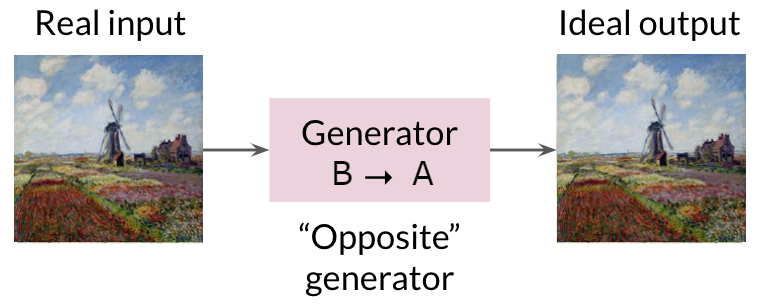

*Diagram showing a monet painting going through a photo -> monet generator and the ideal output being the same input image*

In [18]:
def get_identity_loss(real_X, gen_YX, identity_criterion):
    identity_X = gen_YX(real_X)
    identity_loss = identity_criterion(identity_X, real_X)   # L1 (mean absolute error) distance between the input image and the image after the cycle translation
    
    return identity_loss, identity_X

#### Cycle Consistency Loss
Now, we can implement the final generator loss, which includes the component that gives 'cycle' its meaning in CycleGAN: cycle consistency loss. This loss will encourage the cycle to preserve as much information as possible.

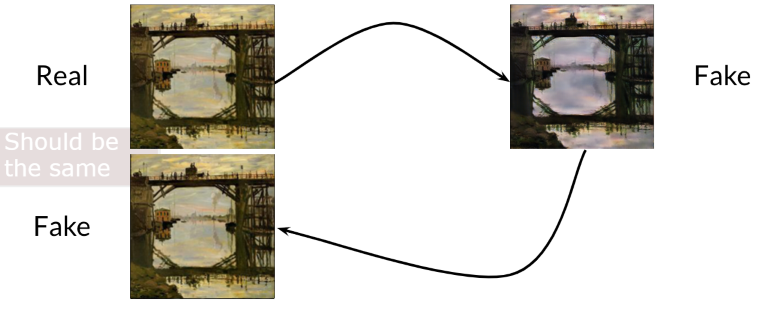

[*Diagram: since we've already generated a fake image for the adversarial part, we can pass that fake image back to produce a full cycle*]

**Note**: Cycle consistency is a broader concept utilized outside of CycleGAN.

In [19]:
def get_cycle_consistency_loss(real_X, fake_Y, gen_YX, cycle_criterion):
    cycle_X = gen_YX(fake_Y)
    cycle_loss = cycle_criterion(cycle_X, real_X)    # L1 (mean absolute error) distance between the input image and the image after the cycle translation
    
    return cycle_loss, cycle_X

#### Generator Loss (Total)
Finally, we can put them all together.

In [20]:
def get_gen_loss(real_A, real_B, gen_AB, gen_BA, disc_A, disc_B, adv_criterion, identity_criterion, cycle_criterion, lambda_identity=0.1, lambda_cycle=10):
    
    # Adversarial Loss -- get_gen_adversarial_loss(real_X, disc_Y, gen_XY, adv_criterion)
    adv_loss_BA, fake_A = get_gen_adversarial_loss(real_B, disc_A, gen_BA, adv_criterion)
    adv_loss_AB, fake_B = get_gen_adversarial_loss(real_A, disc_B, gen_AB, adv_criterion)
    gen_adversarial_loss = adv_loss_BA + adv_loss_AB
    
    # Identity Loss -- get_identity_loss(real_X, gen_YX, identity_criterion)
    identity_loss_A, identity_A = get_identity_loss(real_A, gen_BA, identity_criterion)
    identity_loss_B, identity_B = get_identity_loss(real_B, gen_AB, identity_criterion)
    gen_identity_loss = identity_loss_A + identity_loss_B
    
    # Cycle-consistency Loss -- get_cycle_consistency_loss(real_X, fake_Y, gen_YX, cycle_criterion)
    cycle_loss_BA, cycle_A = get_cycle_consistency_loss(real_A, fake_B, gen_BA, cycle_criterion)
    cycle_loss_AB, cycle_B = get_cycle_consistency_loss(real_B, fake_A, gen_AB, cycle_criterion)
    gen_cycle_loss = cycle_loss_BA + cycle_loss_AB
    
    # Total loss
    gen_loss = lambda_identity * gen_identity_loss + lambda_cycle * gen_cycle_loss + gen_adversarial_loss

    return gen_loss, fake_A, fake_B

## 4. Results and Analysis

In [21]:
import torch.nn.functional as F

plt.rcParams['figure.figsize'] = (8, 8)

In [22]:
adv_criterion = nn.MSELoss() 
recon_criterion = nn.L1Loss() 

dim_A = 3
dim_B = 3
batch_size = 4
lr = 0.0002
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [23]:
def train(dataset, n_epochs, display_step, filename, model_path, pretrained=True, save_model=False):
    generator_loss = []
    discriminator_loss = []
    mean_generator_loss = 0
    mean_discriminator_loss = 0
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
    cur_step = 0
    
    gen_AB, gen_BA, gen_opt, disc_A, disc_A_opt, disc_B, disc_B_opt = init_gen_disc(model_path=model_path, pretrained=pretrained)
    
    for epoch in range(n_epochs):
        # dataloader returns the batches
        for real_A, real_B in tqdm(dataloader):
            real_A = nn.functional.interpolate(real_A, size=target_shape)
            real_B = nn.functional.interpolate(real_B, size=target_shape)
            cur_batch_size = len(real_A)
            real_A = real_A.to(device)
            real_B = real_B.to(device)

            # update discriminator A
            disc_A_opt.zero_grad()                       # Zero out the gradient before backpropagation
            with torch.no_grad():
                fake_A = gen_BA(real_B)
            disc_A_loss = get_disc_loss(real_A, fake_A, disc_A, adv_criterion)
            disc_A_loss.backward(retain_graph=True)      # Update gradients
            disc_A_opt.step()                            # Update optimizer

            # update discriminator B
            disc_B_opt.zero_grad()                       # Zero out the gradient before backpropagation
            with torch.no_grad():
                fake_B = gen_AB(real_A)
            disc_B_loss = get_disc_loss(real_B, fake_B, disc_B, adv_criterion)
            disc_B_loss.backward(retain_graph=True)      # Update gradients
            disc_B_opt.step()                            # Update optimizer

            # update generator
            gen_opt.zero_grad()
            gen_loss, fake_A, fake_B = get_gen_loss(
                real_A, real_B, gen_AB, gen_BA, disc_A, disc_B, adv_criterion, recon_criterion, recon_criterion
            )
            gen_loss.backward()                          # Update gradients
            gen_opt.step()                               # Update optimizer

            # keep track of the average discriminator loss
            mean_discriminator_loss += disc_A_loss.item() / display_step
            
            # keep track of the average generator loss
            mean_generator_loss += gen_loss.item() / display_step

            # save the losses
            if cur_step % display_step == 0:
                print(f'Epoch {epoch}: Step {cur_step}: Generator (U-Net) loss: {mean_generator_loss}, Discriminator loss: {mean_discriminator_loss}')
                generator_loss.append(mean_generator_loss)
                discriminator_loss.append(mean_discriminator_loss)
                mean_generator_loss = 0
                mean_discriminator_loss = 0          

            # visualization
            if cur_step % (display_step*10) == 0 and cur_step != 0:
                show_tensor_images(torch.cat([real_A, real_B]), size=(dim_A, target_shape, target_shape), title='Real Augmented')
                show_tensor_images(torch.cat([fake_B, fake_A]), size=(dim_B, target_shape, target_shape), title='Fake')
                if save_model and cur_step != 0:
                    save_path = filename + str(cur_step) + '.pth'
                    torch.save({
                        'gen_AB': gen_AB.state_dict(),
                        'gen_BA': gen_BA.state_dict(),
                        'gen_opt': gen_opt.state_dict(),
                        'disc_A': disc_A.state_dict(),
                        'disc_A_opt': disc_A_opt.state_dict(),
                        'disc_B': disc_B.state_dict(),
                        'disc_B_opt': disc_B_opt.state_dict()
                    }, save_path)
            cur_step += 1

    return gen_BA, generator_loss, discriminator_loss    # gen_BA: generator photo (B) to monet (A)

### Training from scratch

  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 0: Step 0: Generator (U-Net) loss: 0.1875890858968099, Discriminator loss: 0.009146045843760173


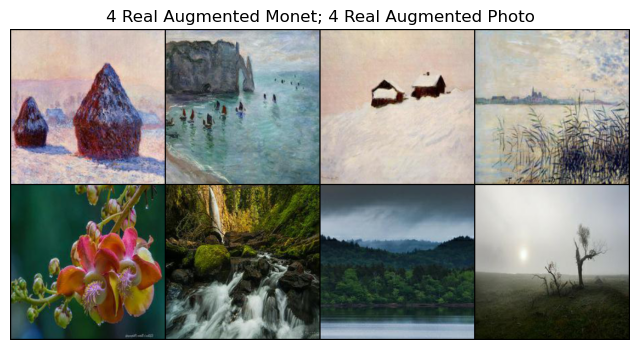

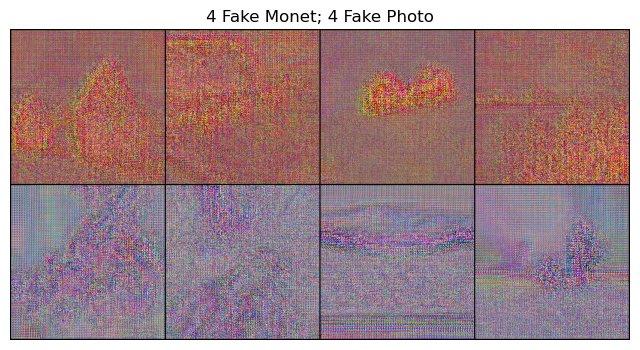

  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 1: Step 75: Generator (U-Net) loss: 7.58444283803304, Discriminator loss: 0.2947233003377915


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 2: Step 150: Generator (U-Net) loss: 6.607199172973633, Discriminator loss: 0.22806040962537136


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 3: Step 225: Generator (U-Net) loss: 6.2575705464680995, Discriminator loss: 0.23590234637260435


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 4: Step 300: Generator (U-Net) loss: 6.147070719401043, Discriminator loss: 0.21668169736862183


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 5: Step 375: Generator (U-Net) loss: 6.157468624114989, Discriminator loss: 0.21509606222311656


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 6: Step 450: Generator (U-Net) loss: 5.75466988881429, Discriminator loss: 0.2068222550551097


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 7: Step 525: Generator (U-Net) loss: 5.961681677500409, Discriminator loss: 0.20045208136240636


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 8: Step 600: Generator (U-Net) loss: 6.0452242469787585, Discriminator loss: 0.1956753802299499


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 9: Step 675: Generator (U-Net) loss: 5.771680920918782, Discriminator loss: 0.1974156715472539


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 10: Step 750: Generator (U-Net) loss: 5.481026191711428, Discriminator loss: 0.20639953394730887


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 11: Step 825: Generator (U-Net) loss: 5.237017237345374, Discriminator loss: 0.20208134710788725


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 12: Step 900: Generator (U-Net) loss: 5.033378667831421, Discriminator loss: 0.21862004558245338


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 13: Step 975: Generator (U-Net) loss: 4.909514722824096, Discriminator loss: 0.21267402887344358


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 14: Step 1050: Generator (U-Net) loss: 4.90476396560669, Discriminator loss: 0.19747246066729227


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 15: Step 1125: Generator (U-Net) loss: 4.957071733474731, Discriminator loss: 0.2016269220908483


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 16: Step 1200: Generator (U-Net) loss: 4.981613499323526, Discriminator loss: 0.18635802686214442


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 17: Step 1275: Generator (U-Net) loss: 4.798613955179851, Discriminator loss: 0.21663343310356137


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 18: Step 1350: Generator (U-Net) loss: 4.689286200205483, Discriminator loss: 0.221750478943189


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 19: Step 1425: Generator (U-Net) loss: 4.7503321297963454, Discriminator loss: 0.21253882845242816


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 20: Step 1500: Generator (U-Net) loss: 4.782903788884481, Discriminator loss: 0.21742398818333944


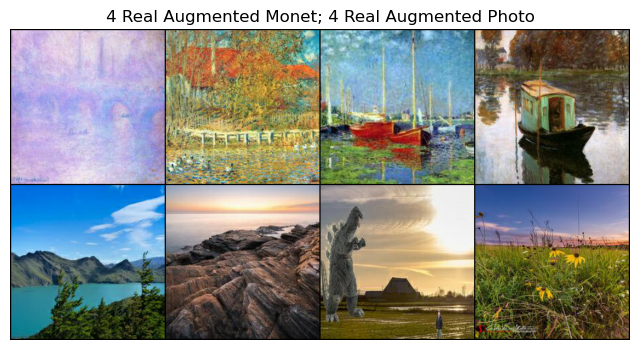

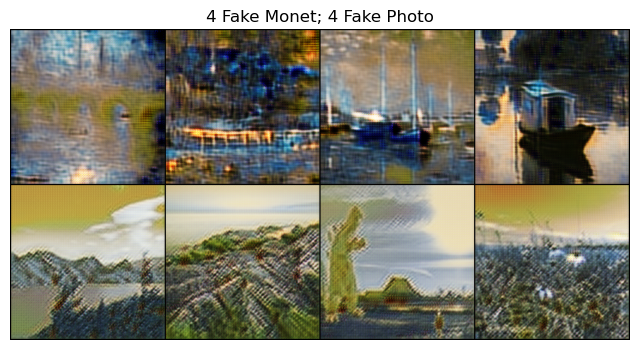

  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 21: Step 1575: Generator (U-Net) loss: 4.6693593152364095, Discriminator loss: 0.2124289709329605


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 22: Step 1650: Generator (U-Net) loss: 4.685921662648517, Discriminator loss: 0.21582655052344


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 23: Step 1725: Generator (U-Net) loss: 4.696449362436931, Discriminator loss: 0.21400808533032747


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 24: Step 1800: Generator (U-Net) loss: 4.5254647636413585, Discriminator loss: 0.20207028488318127


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 25: Step 1875: Generator (U-Net) loss: 4.590902872085572, Discriminator loss: 0.2274920139710108


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 26: Step 1950: Generator (U-Net) loss: 4.6535147571563735, Discriminator loss: 0.2165085554122925


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 27: Step 2025: Generator (U-Net) loss: 4.506569995880127, Discriminator loss: 0.20974331438541416


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 28: Step 2100: Generator (U-Net) loss: 4.48464464187622, Discriminator loss: 0.21297733128070825


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 29: Step 2175: Generator (U-Net) loss: 4.556902605692544, Discriminator loss: 0.20828257282574977


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 30: Step 2250: Generator (U-Net) loss: 4.551882578531902, Discriminator loss: 0.21052050868670158


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 31: Step 2325: Generator (U-Net) loss: 4.620982710520425, Discriminator loss: 0.20330736001332606


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 32: Step 2400: Generator (U-Net) loss: 4.526933399836222, Discriminator loss: 0.20191359241803492


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 33: Step 2475: Generator (U-Net) loss: 4.536120131810505, Discriminator loss: 0.2016917937994003


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 34: Step 2550: Generator (U-Net) loss: 4.622968311309815, Discriminator loss: 0.20650661706924436


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 35: Step 2625: Generator (U-Net) loss: 4.378399130503337, Discriminator loss: 0.19789327800273887


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 36: Step 2700: Generator (U-Net) loss: 4.447666212717692, Discriminator loss: 0.21698675553003954


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 37: Step 2775: Generator (U-Net) loss: 4.543086719512937, Discriminator loss: 0.1976668061812719


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 38: Step 2850: Generator (U-Net) loss: 4.49795558611552, Discriminator loss: 0.19364757974942529


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 39: Step 2925: Generator (U-Net) loss: 4.495277579625446, Discriminator loss: 0.196208116610845


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 40: Step 3000: Generator (U-Net) loss: 4.513808116912841, Discriminator loss: 0.19781350354353583


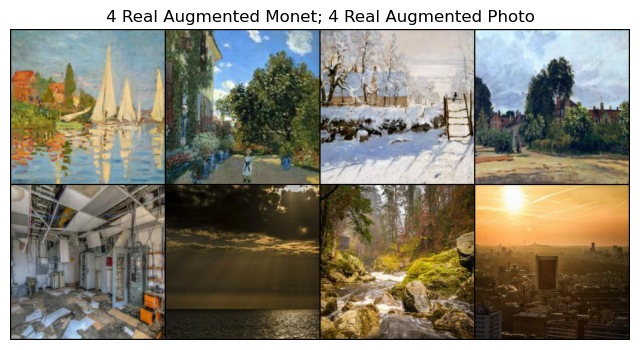

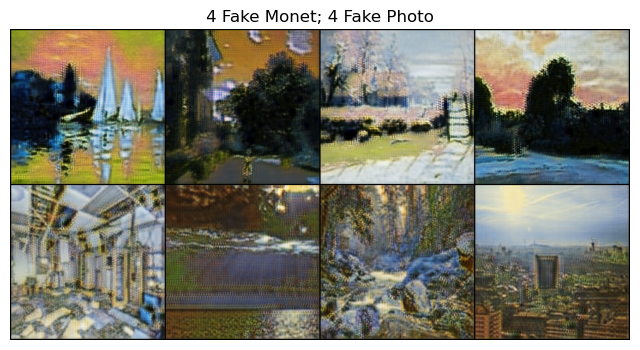

  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 41: Step 3075: Generator (U-Net) loss: 4.342424179712933, Discriminator loss: 0.1994639954964319


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 42: Step 3150: Generator (U-Net) loss: 4.575906661351523, Discriminator loss: 0.1882960677146912


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 43: Step 3225: Generator (U-Net) loss: 4.391164894104004, Discriminator loss: 0.2294151514768601


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 44: Step 3300: Generator (U-Net) loss: 4.167563683191935, Discriminator loss: 0.2558311547835668


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 45: Step 3375: Generator (U-Net) loss: 4.151607364018756, Discriminator loss: 0.25611482401688895


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 46: Step 3450: Generator (U-Net) loss: 4.2011830997467055, Discriminator loss: 0.25078146119912464


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 47: Step 3525: Generator (U-Net) loss: 4.126987145741781, Discriminator loss: 0.250414458711942


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 48: Step 3600: Generator (U-Net) loss: 3.8144846630096443, Discriminator loss: 0.2475734939177831


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 49: Step 3675: Generator (U-Net) loss: 3.730732971827189, Discriminator loss: 0.24246054172515868


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 50: Step 3750: Generator (U-Net) loss: 3.7396533171335857, Discriminator loss: 0.24144799828529354


In [26]:
generator_photo_to_monet, generator_loss, discriminator_loss = train(dataset, 
                                                                     n_epochs=51, 
                                                                     display_step=75, 
                                                                     filename='cycleGAN_scratch', 
                                                                     model_path='', 
                                                                     pretrained=False, 
                                                                     save_model=True)

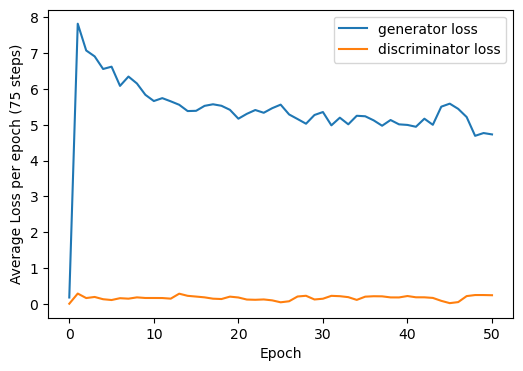

In [27]:
plt.figure(figsize=(6, 4))
plt.plot(np.arange(51), generator_loss, label='generator loss')
plt.plot(np.arange(51), discriminator_loss, label='discriminator loss')
plt.xlabel('Epoch')
plt.ylabel('Average Loss per epoch (75 steps)')
plt.legend();

### Utils Functions for Visualizing Sample Predictions

In [20]:
class SamplePhotoDataset(Dataset):
    def __init__(self, photo_dir):
        super().__init__()
        self.photo_dir = photo_dir
        self.photo_idx = dict()
        self.transform = transforms.Compose([
            transforms.Resize((256, 256)),
            transforms.ToTensor(),
        ])
        for i, filename in enumerate(os.listdir(self.photo_dir)[:5]):
            self.photo_idx[i] = filename

    def __getitem__(self, idx):
        photo_path = os.path.join(self.photo_dir, self.photo_idx[idx])
        photo_img = Image.open(photo_path)
        photo_img = self.transform(photo_img)
        return (photo_img - 0.5) * 2

    def __len__(self):
        return len(self.photo_idx.keys())

In [21]:
def unnorm(img, mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]):
    for t, m, s in zip(img, mean, std):
        t.mul_(s).add_(s)        
    return img

In [41]:
def get_sample_preds(gen, photo_dir='photo_jpg'):
    photo_ds = SamplePhotoDataset(photo_dir)
    photo_dl = DataLoader(photo_ds, batch_size=1, pin_memory=True)
    transf = transforms.ToPILImage()
    t = tqdm(photo_dl, leave=False, total=photo_dl.__len__())
    preds_imgs = []
    for i, photo in enumerate(t):
        with torch.no_grad():
            predict_monet = gen(photo.to(device)).cpu().detach()
        predict_monet = unnorm(predict_monet)
        img = transf(predict_monet[0]).convert('RGB')
        preds_imgs.append(img)

    original_photos = os.listdir('photo_jpg')[:5]
    photo_dir = 'photo_jpg'
    original_imgs = []
    for i in range(5):
        photo_path = os.path.join(photo_dir, original_photos[i])
        photo_img = plt.imread(photo_path)
        original_imgs.append(photo_img)
    return preds_imgs, original_imgs

### Continue Training (Epoch: 50-100)
To make this notebook concise, I have removed the output for this training session.

In [ ]:
generator_photo_to_monet, generator_loss, discriminator_loss = train(dataset, 
                                                                     n_epochs=51, 
                                                                     display_step=75, 
                                                                     filename='cycleGAN_2ndrun_scratch', 
                                                                     model_path='cycleGAN_scratch3750.pth', 
                                                                     pretrained=True, 
                                                                     save_model=True)

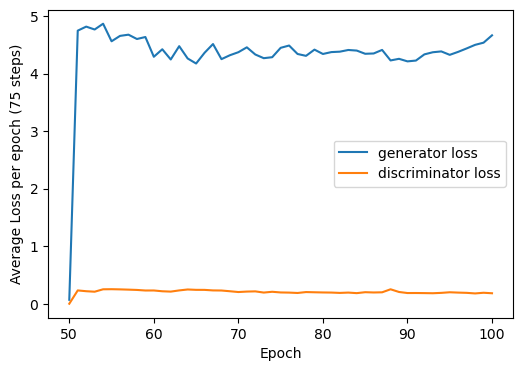

In [30]:
plt.figure(figsize=(6, 4))
plt.plot(np.arange(51)+50, generator_loss, label='generator loss')
plt.plot(np.arange(51)+50, discriminator_loss, label='discriminator loss')
plt.xlabel('Epoch')
plt.ylabel('Average Loss per epoch (75 steps)')
plt.legend();

Noticed: generator loss started to increase pass epochs around 95: overfitting or model collapse?

### Visualize generator photo to monet output after 100 epoch training from scratch

In [31]:
preds_imgs, original_imgs = get_sample_preds(generator_photo_to_monet)

  0%|          | 0/5 [00:00<?, ?it/s]

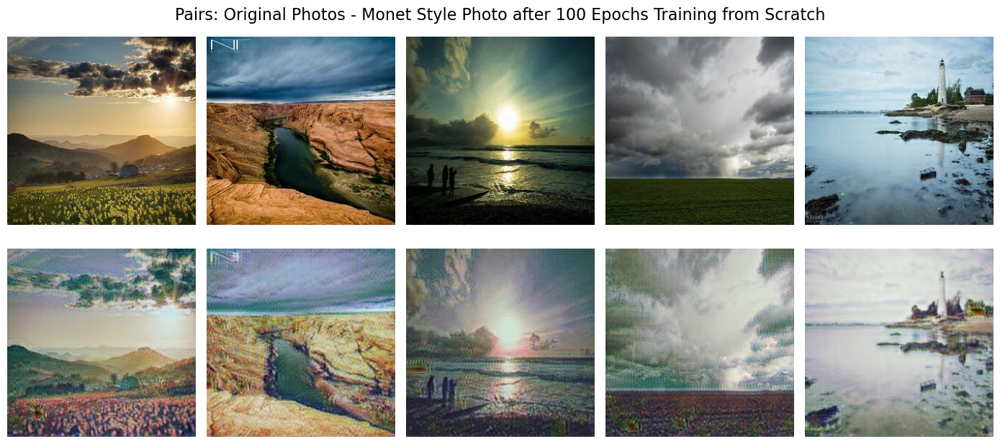

In [32]:
plt.figure(figsize=(14, 7))
plt.suptitle('Pairs: Original Photos - Monet Style Photo after 100 Epochs Training from Scratch', y=0.93, fontsize=16)
for i in range(5):
    plt.subplot(2, 5, i+1)
    plt.imshow(original_imgs[i])
    plt.axis('off')

for i in range(5):
    plt.subplot(2, 5, i+6)
    plt.imshow(preds_imgs[i])
    plt.axis('off')

plt.tight_layout()

Kaggle Score with spatial transformations applied to image tensor, training for 100 epochs:

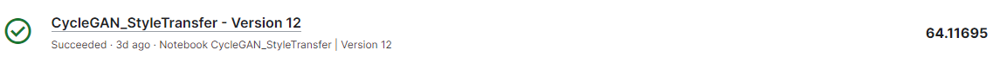

Kaggle Score without data augmentation, training for 100 epochs:

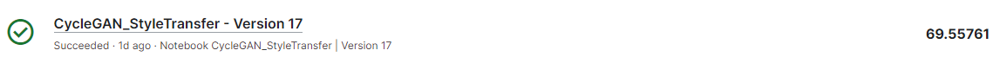

## Transfer Learning
### Fine Tuning pre-trained Model
I will utilize a pre-trained CycleGAN model, trained on ImageNet categories horse and zebra. This pre-trained model is sourced from the Generative Adversarial Networks (GANs) Specialization Course. I'm hoping that this will accelerate the learning process, given that the pre-trained model has already learned to extract low-level features relevant to style transfer tasks, such as texture, color, and shape characteristics specific to horses and zebras. These features can be leveraged for our task without needing to start from scratch. 

  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 0: Step 0: Generator (U-Net) loss: 0.03966413497924805, Discriminator loss: 0.004914724826812744


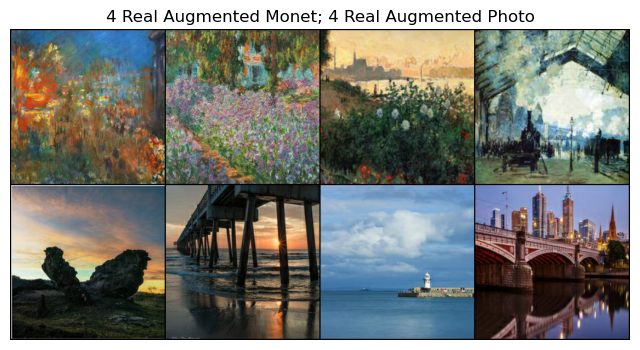

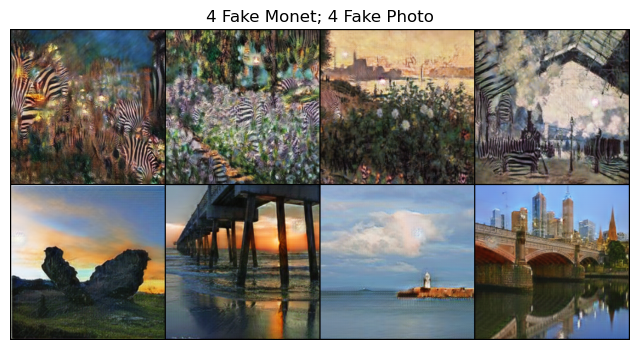

  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 1: Step 75: Generator (U-Net) loss: 3.472631130218507, Discriminator loss: 0.23692972997824358


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 2: Step 150: Generator (U-Net) loss: 3.359186795552572, Discriminator loss: 0.2286246472597122


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 3: Step 225: Generator (U-Net) loss: 3.2539396286010738, Discriminator loss: 0.22016032636165622


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 4: Step 300: Generator (U-Net) loss: 3.098297783533732, Discriminator loss: 0.21560498237609863


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 5: Step 375: Generator (U-Net) loss: 3.0329967085520426, Discriminator loss: 0.2181167034308115


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 6: Step 450: Generator (U-Net) loss: 2.983809754053752, Discriminator loss: 0.21450163304805758


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 7: Step 525: Generator (U-Net) loss: 3.0614501984914138, Discriminator loss: 0.21182468891143796


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 8: Step 600: Generator (U-Net) loss: 2.995437650680542, Discriminator loss: 0.20769723355770112


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 9: Step 675: Generator (U-Net) loss: 2.9682072512308757, Discriminator loss: 0.20985906581083932


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 10: Step 750: Generator (U-Net) loss: 2.893686577479045, Discriminator loss: 0.208380801876386


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 11: Step 825: Generator (U-Net) loss: 2.8863219928741453, Discriminator loss: 0.2046180462837219


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 12: Step 900: Generator (U-Net) loss: 2.982220344543457, Discriminator loss: 0.20356943686803186


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 13: Step 975: Generator (U-Net) loss: 2.9304968229929598, Discriminator loss: 0.2060295675198237


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 14: Step 1050: Generator (U-Net) loss: 2.8474001884460445, Discriminator loss: 0.20374667545159647


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 15: Step 1125: Generator (U-Net) loss: 2.848228603998819, Discriminator loss: 0.20677653670310972


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 16: Step 1200: Generator (U-Net) loss: 2.818583669662476, Discriminator loss: 0.20180923859278357


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 17: Step 1275: Generator (U-Net) loss: 2.8753859392801924, Discriminator loss: 0.20604883174101501


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 18: Step 1350: Generator (U-Net) loss: 2.85418573697408, Discriminator loss: 0.20577128549416854


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 19: Step 1425: Generator (U-Net) loss: 2.7916283098856614, Discriminator loss: 0.19956533690293637


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 20: Step 1500: Generator (U-Net) loss: 2.8306826718648264, Discriminator loss: 0.20423553307851153


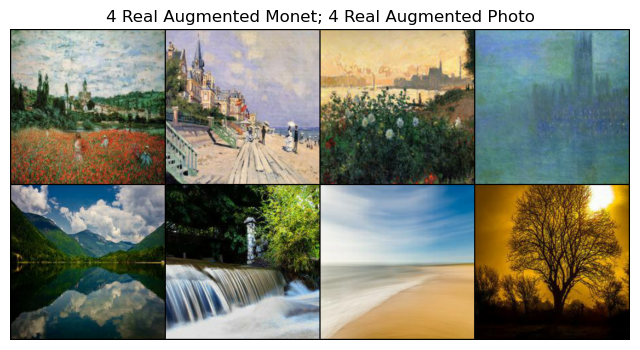

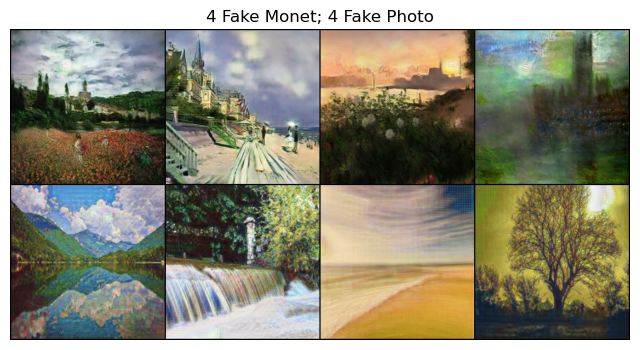

  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 21: Step 1575: Generator (U-Net) loss: 2.8544525623321535, Discriminator loss: 0.19750956108172732


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 22: Step 1650: Generator (U-Net) loss: 2.7511869653065997, Discriminator loss: 0.19803563078244527


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 23: Step 1725: Generator (U-Net) loss: 2.8167021147410085, Discriminator loss: 0.19786689420541118


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 24: Step 1800: Generator (U-Net) loss: 2.718439785639445, Discriminator loss: 0.1976127338409424


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 25: Step 1875: Generator (U-Net) loss: 2.717517245610556, Discriminator loss: 0.2006650994221369


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 26: Step 1950: Generator (U-Net) loss: 2.7021092096964514, Discriminator loss: 0.19860513925552364


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 27: Step 2025: Generator (U-Net) loss: 2.7903399721781414, Discriminator loss: 0.19652393917242683


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 28: Step 2100: Generator (U-Net) loss: 2.7514186096191415, Discriminator loss: 0.19747655729452768


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 29: Step 2175: Generator (U-Net) loss: 2.7729109414418542, Discriminator loss: 0.19415341039498643


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 30: Step 2250: Generator (U-Net) loss: 2.7252824560801185, Discriminator loss: 0.19643644293149312


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 31: Step 2325: Generator (U-Net) loss: 2.6399662907918287, Discriminator loss: 0.1958887950579325


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 32: Step 2400: Generator (U-Net) loss: 2.792527831395467, Discriminator loss: 0.1893906567494074


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 33: Step 2475: Generator (U-Net) loss: 2.724363209406535, Discriminator loss: 0.19224773188432057


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 34: Step 2550: Generator (U-Net) loss: 2.7382583395640063, Discriminator loss: 0.1917483882109324


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 35: Step 2625: Generator (U-Net) loss: 2.723978462219239, Discriminator loss: 0.2000180751085281


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 36: Step 2700: Generator (U-Net) loss: 2.70564645131429, Discriminator loss: 0.1942147835095724


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 37: Step 2775: Generator (U-Net) loss: 2.6567488384246833, Discriminator loss: 0.19230166514714556


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 38: Step 2850: Generator (U-Net) loss: 2.708243074417114, Discriminator loss: 0.1922866785526276


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 39: Step 2925: Generator (U-Net) loss: 2.6945145161946606, Discriminator loss: 0.19408497889836623


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 40: Step 3000: Generator (U-Net) loss: 2.6483313433329254, Discriminator loss: 0.18880269567171742


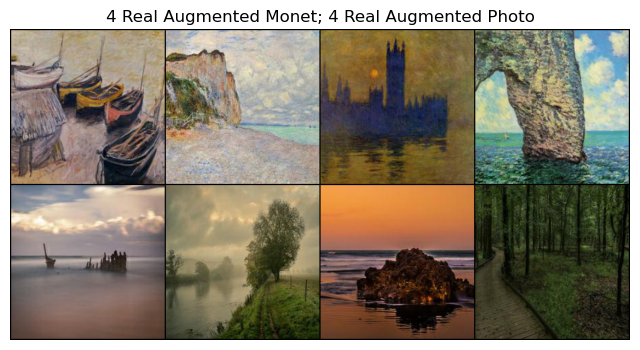

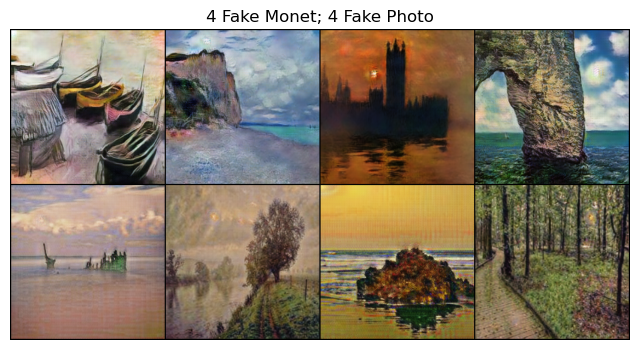

  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 41: Step 3075: Generator (U-Net) loss: 2.6239489936828617, Discriminator loss: 0.18940126587947212


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 42: Step 3150: Generator (U-Net) loss: 2.66345983505249, Discriminator loss: 0.1926635535558065


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 43: Step 3225: Generator (U-Net) loss: 2.5964526589711507, Discriminator loss: 0.1926076251268387


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 44: Step 3300: Generator (U-Net) loss: 2.6950737984975186, Discriminator loss: 0.19223175138235088


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 45: Step 3375: Generator (U-Net) loss: 2.676465050379436, Discriminator loss: 0.18771917819976805


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 46: Step 3450: Generator (U-Net) loss: 2.6030062866210937, Discriminator loss: 0.18761575877666478


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 47: Step 3525: Generator (U-Net) loss: 2.593213059107462, Discriminator loss: 0.18677984734376274


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 48: Step 3600: Generator (U-Net) loss: 2.6598634020487473, Discriminator loss: 0.18525081257025408


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 49: Step 3675: Generator (U-Net) loss: 2.6611484305063873, Discriminator loss: 0.18673573672771457


  0%|          | 0/75 [00:00<?, ?it/s]

Epoch 50: Step 3750: Generator (U-Net) loss: 2.6445436096191415, Discriminator loss: 0.1848955589532851


In [20]:
generator_photo_to_monet, generator_loss, discriminator_loss = train(dataset, 
                                                                     n_epochs=51, 
                                                                     display_step=75, 
                                                                     filename='cycleGAN_pretrained', 
                                                                     model_path='cycleGAN_100000.pth',
                                                                     pretrained=True, 
                                                                     save_model=True)

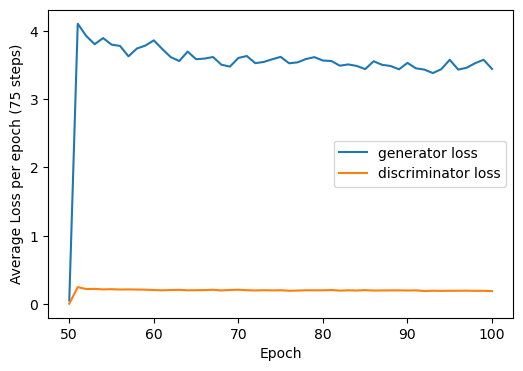

In [24]:
plt.figure(figsize=(6, 4))
plt.plot(np.arange(51)+50, generator_loss, label='generator loss')
plt.plot(np.arange(51)+50, discriminator_loss, label='discriminator loss')
plt.xlabel('Epoch')
plt.ylabel('Average Loss per epoch (75 steps)')
plt.legend();

### Continue Training (Epoch: 50-100)
Again, I have removed training output on this session in order to make this notebook concise.

In [ ]:
generator_photo_to_monet, generator_loss, discriminator_loss = train(dataset, 
                                                                     n_epochs=51, 
                                                                     display_step=75, 
                                                                     filename='cycleGAN_2ndrun_pretrained', 
                                                                     model_path='cycleGAN_pretrained3750.pth',
                                                                     pretrained=True, 
                                                                     save_model=True)

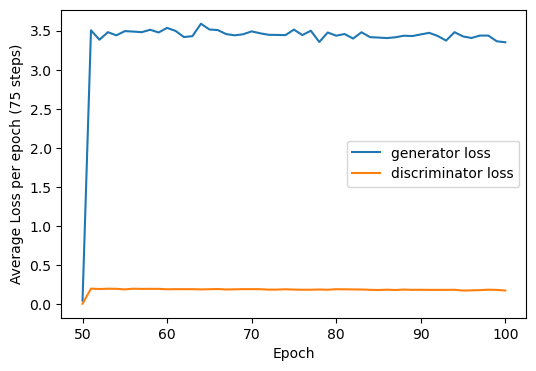

In [32]:
plt.figure(figsize=(6, 4))
plt.plot(np.arange(51)+50, generator_loss, label='generator loss')
plt.plot(np.arange(51)+50, discriminator_loss, label='discriminator loss')
plt.xlabel('Epoch')
plt.ylabel('Average Loss per epoch (75 steps)')
plt.legend();

In [36]:
np.array(discriminator_loss).min()

0.0029051093260447185

### Visualize generator photo to monet output after 100 epoch training from pretrained model

In [33]:
preds_imgs, original_imgs = get_sample_preds(generator_photo_to_monet)

  0%|          | 0/5 [00:00<?, ?it/s]

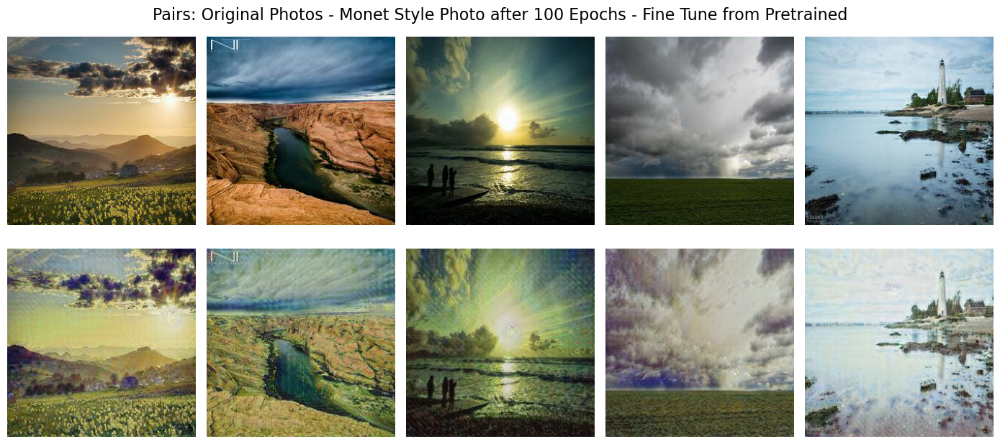

In [38]:
plt.figure(figsize=(14, 7))
plt.suptitle('Pairs: Original Photos - Monet Style Photo after 100 Epochs - Fine Tune from Pretrained', y=0.93, fontsize=16)
for i in range(5):
    plt.subplot(2, 5, i+1)
    plt.imshow(original_imgs[i])
    plt.axis('off')

for i in range(5):
    plt.subplot(2, 5, i+6)
    plt.imshow(preds_imgs[i])
    plt.axis('off')

plt.tight_layout()

We can see that there are checkerboard artifacts on the generated Monet style photos.

Kaggle Score on this Model:

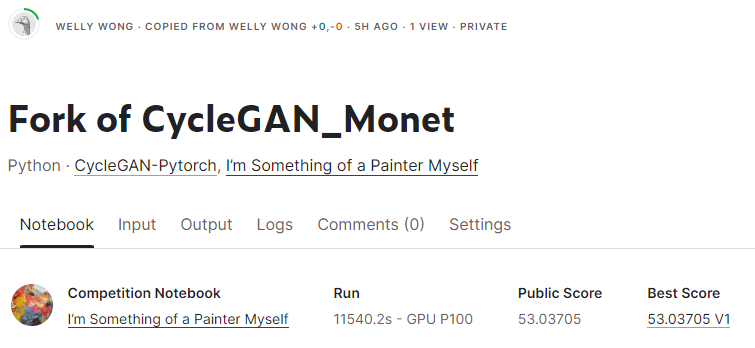

### Additional Monet Painting Images - Berkeley Dataset
Next, we will train with an additional 1193 JPG image files of Monet paintings from the Berkeley dataset. Credit: Dimitre Oliveira [Kaggle Link](https://www.kaggle.com/datasets/dimitreoliveira/monet-paintings-jpg-berkeley/data)

I did not submit the results of training with additional Monet paintings as the extra data is not part of the Kaggle competition. I simply wanted to visualize the outcomes.

In [24]:
plt.rcParams['figure.figsize'] = (10, 10)

In [25]:
monet2_path = glob.glob('monet2_jpg/*.jpg')
print('Number of Monet images:', len(monet2_path))
print('Monet image shape:', plt.imread(monet2_path[0]).shape)

Number of Monet images: 1493
Monet image shape: (256, 256, 3)


In [26]:
dataset = ImageDataset(monet2_path, photo_path, transform=transform)

  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 0: Step 0: Generator (U-Net) loss: 0.011350542466270732, Discriminator loss: 0.001064680795618557


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 1: Step 374: Generator (U-Net) loss: 3.4882770011769257, Discriminator loss: 0.22530941202997534


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 2: Step 748: Generator (U-Net) loss: 3.2932211562273994, Discriminator loss: 0.20710678920548228


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 3: Step 1122: Generator (U-Net) loss: 3.2589729966964294, Discriminator loss: 0.20059640518324875


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 4: Step 1496: Generator (U-Net) loss: 3.1675517214810776, Discriminator loss: 0.1938779044517859


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 5: Step 1870: Generator (U-Net) loss: 3.1707069229952145, Discriminator loss: 0.18873543889924163


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 6: Step 2244: Generator (U-Net) loss: 3.0747038030369414, Discriminator loss: 0.18860442820876674


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 7: Step 2618: Generator (U-Net) loss: 3.053856655238145, Discriminator loss: 0.183573134283331


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 8: Step 2992: Generator (U-Net) loss: 3.0652263604383463, Discriminator loss: 0.18022863640584408


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 9: Step 3366: Generator (U-Net) loss: 3.0453397214093965, Discriminator loss: 0.178055538731144


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 10: Step 3740: Generator (U-Net) loss: 3.0227853040644193, Discriminator loss: 0.1762807239345051


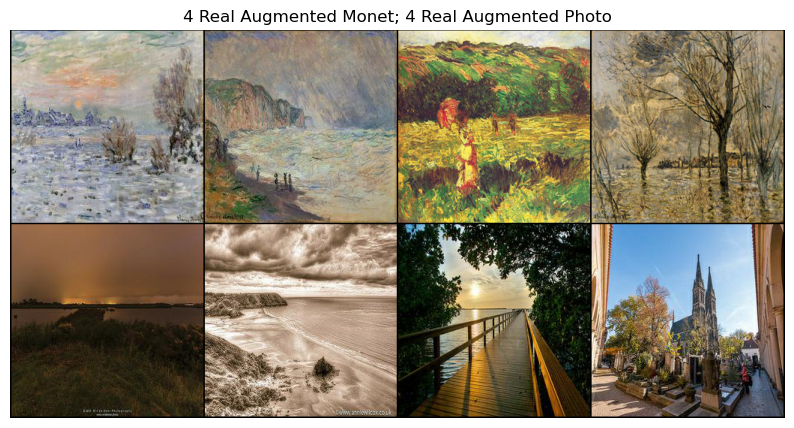

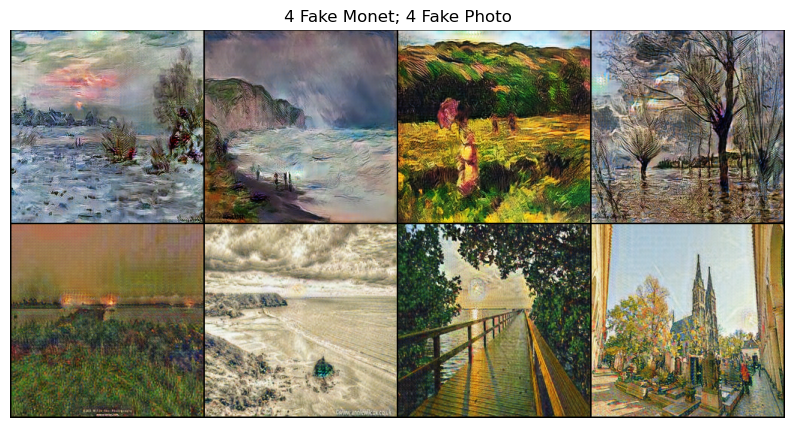

  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 11: Step 4114: Generator (U-Net) loss: 2.9982405276222015, Discriminator loss: 0.17301601221296867


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 12: Step 4488: Generator (U-Net) loss: 3.00685190262004, Discriminator loss: 0.1725340445929352


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 13: Step 4862: Generator (U-Net) loss: 2.974782025112826, Discriminator loss: 0.17174424647408384


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 14: Step 5236: Generator (U-Net) loss: 2.924340290181777, Discriminator loss: 0.16815571130357967


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 15: Step 5610: Generator (U-Net) loss: 2.991157884266284, Discriminator loss: 0.16629654752777853


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 16: Step 5984: Generator (U-Net) loss: 2.9334173897370937, Discriminator loss: 0.16627534719951023


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 17: Step 6358: Generator (U-Net) loss: 2.913481296702503, Discriminator loss: 0.16413753720767363


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 18: Step 6732: Generator (U-Net) loss: 2.921809330343562, Discriminator loss: 0.1607786417605087


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 19: Step 7106: Generator (U-Net) loss: 2.9373163603206383, Discriminator loss: 0.15914259305134187


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 20: Step 7480: Generator (U-Net) loss: 2.933822225759374, Discriminator loss: 0.15851494132038105


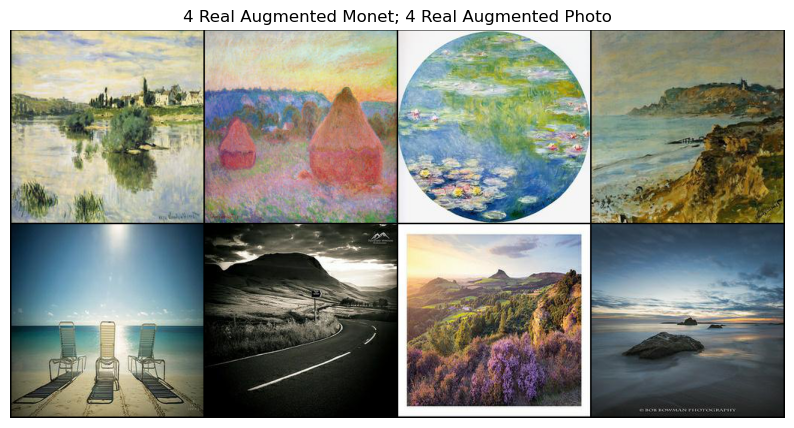

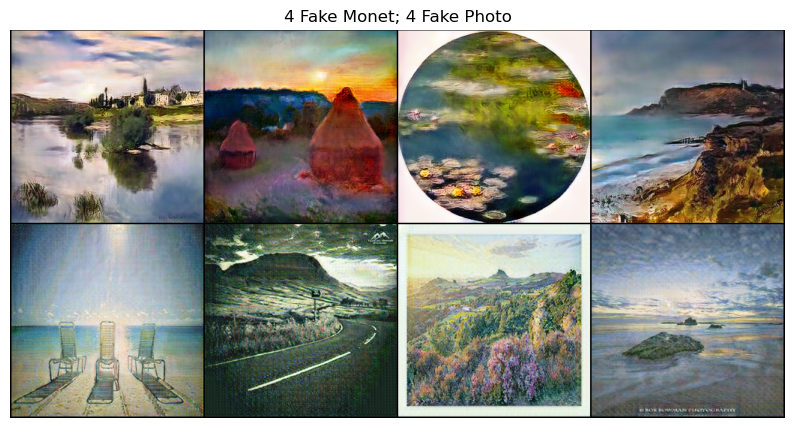

  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 21: Step 7854: Generator (U-Net) loss: 2.9164419288941232, Discriminator loss: 0.15843443713962696


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 22: Step 8228: Generator (U-Net) loss: 2.9130293959602303, Discriminator loss: 0.1553498666115941


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 23: Step 8602: Generator (U-Net) loss: 2.8835189973606776, Discriminator loss: 0.1560002626343207


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 24: Step 8976: Generator (U-Net) loss: 2.8733294889888645, Discriminator loss: 0.15636175522271967


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 25: Step 9350: Generator (U-Net) loss: 2.8792819001457883, Discriminator loss: 0.15662474225071038


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 26: Step 9724: Generator (U-Net) loss: 2.8639661354177135, Discriminator loss: 0.1539612928016938


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 27: Step 10098: Generator (U-Net) loss: 2.869539091293824, Discriminator loss: 0.1539779275177633


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 28: Step 10472: Generator (U-Net) loss: 2.8664967892641693, Discriminator loss: 0.1521663449425749


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 29: Step 10846: Generator (U-Net) loss: 2.906285294236986, Discriminator loss: 0.15152029252865098


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 30: Step 11220: Generator (U-Net) loss: 2.902255051276262, Discriminator loss: 0.1505569801889958


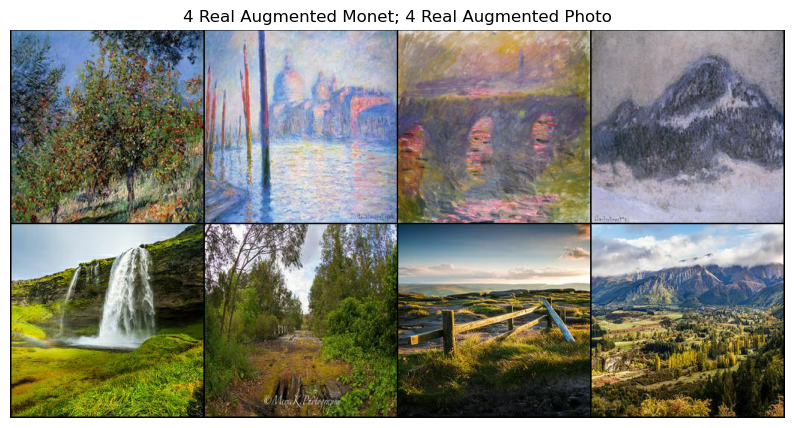

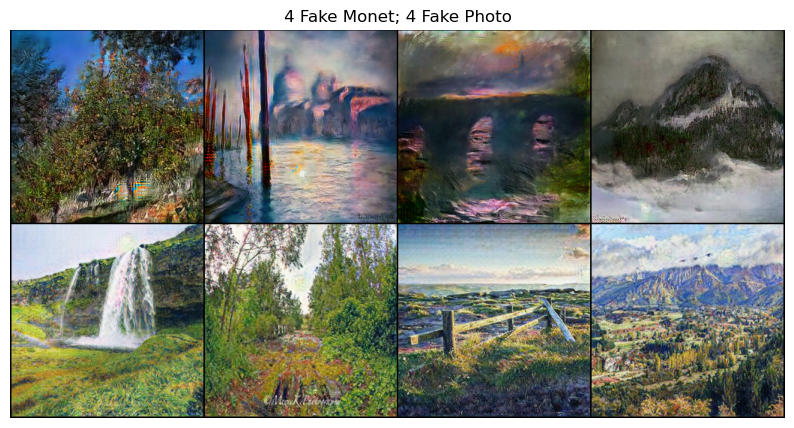

  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 31: Step 11594: Generator (U-Net) loss: 2.8768094421070547, Discriminator loss: 0.14851266087934292


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 32: Step 11968: Generator (U-Net) loss: 2.8673569072376566, Discriminator loss: 0.1488588720081961


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 33: Step 12342: Generator (U-Net) loss: 2.8402355520483002, Discriminator loss: 0.14748450998157103


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 34: Step 12716: Generator (U-Net) loss: 2.8954102483025217, Discriminator loss: 0.14390064698250538


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 35: Step 13090: Generator (U-Net) loss: 2.878153895949297, Discriminator loss: 0.1466046449613762


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 36: Step 13464: Generator (U-Net) loss: 2.8931062272525714, Discriminator loss: 0.14356520495073688


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 37: Step 13838: Generator (U-Net) loss: 2.860456448825287, Discriminator loss: 0.14360635179807152


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 38: Step 14212: Generator (U-Net) loss: 2.909029006320523, Discriminator loss: 0.14128938315306766


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 39: Step 14586: Generator (U-Net) loss: 2.8599313503918182, Discriminator loss: 0.1417438619157528


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 40: Step 14960: Generator (U-Net) loss: 2.897779223753171, Discriminator loss: 0.14094073227781026


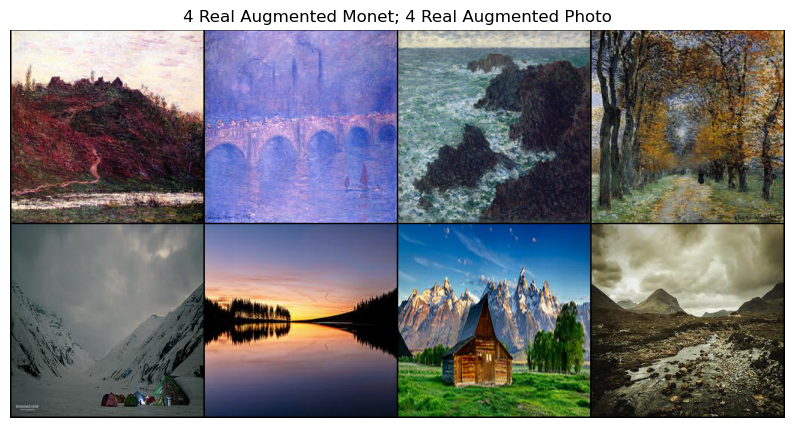

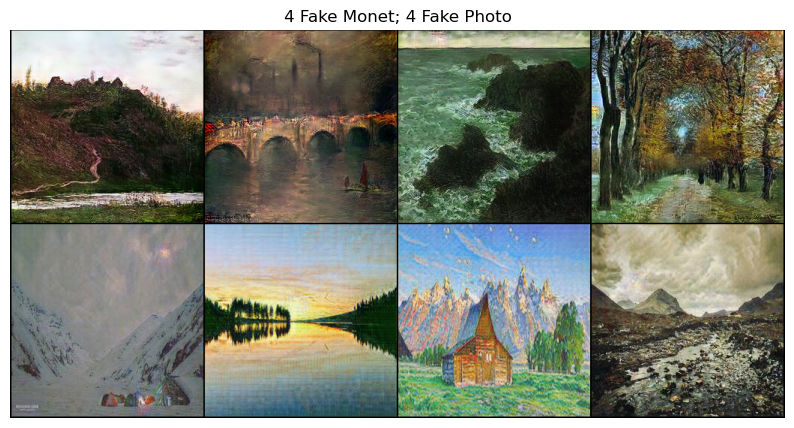

  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 41: Step 15334: Generator (U-Net) loss: 2.836563170274948, Discriminator loss: 0.1419124575580825


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 42: Step 15708: Generator (U-Net) loss: 2.886104173838774, Discriminator loss: 0.1412357917045527


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 43: Step 16082: Generator (U-Net) loss: 2.9121311699005394, Discriminator loss: 0.1389129055056342


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 44: Step 16456: Generator (U-Net) loss: 2.892318070253587, Discriminator loss: 0.1379290418350761


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 45: Step 16830: Generator (U-Net) loss: 2.8792414779969056, Discriminator loss: 0.13755234263160018


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 46: Step 17204: Generator (U-Net) loss: 2.856286034864537, Discriminator loss: 0.13848757705984902


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 47: Step 17578: Generator (U-Net) loss: 2.900585680084431, Discriminator loss: 0.13728773285121845


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 48: Step 17952: Generator (U-Net) loss: 2.9124205144331423, Discriminator loss: 0.13426652490933316


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 49: Step 18326: Generator (U-Net) loss: 2.8840226725461005, Discriminator loss: 0.13533936086344858


  0%|          | 0/374 [00:00<?, ?it/s]

Epoch 50: Step 18700: Generator (U-Net) loss: 2.892293084113992, Discriminator loss: 0.13387900684526916


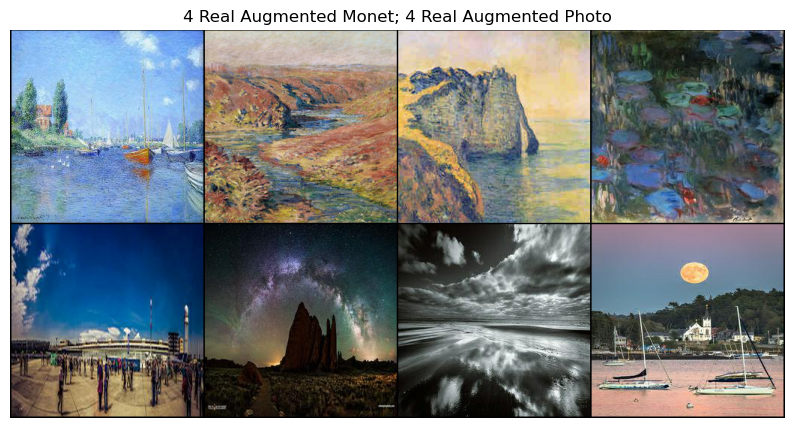

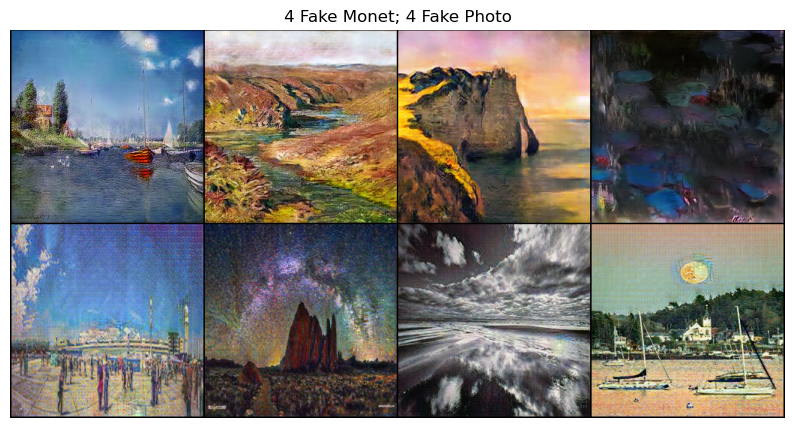

In [27]:
generator_photo_to_monet, generator_loss, discriminator_loss = train(dataset, 
                                                                     n_epochs=51, 
                                                                     display_step=374, 
                                                                     filename='cycleGAN_pretrained_plus', 
                                                                     model_path='cycleGAN_100000.pth', 
                                                                     pretrained=True, 
                                                                     save_model=True)

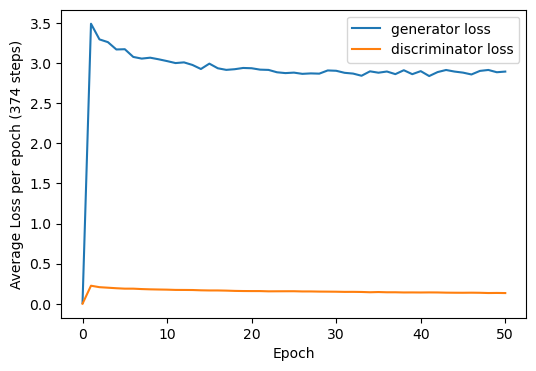

In [28]:
plt.figure(figsize=(6, 4))
plt.plot(np.arange(51), generator_loss, label='generator loss')
plt.plot(np.arange(51), discriminator_loss, label='discriminator loss')
plt.xlabel('Epoch')
plt.ylabel('Average Loss per epoch (374 steps)')
plt.legend();

### Load Both Trained Generators and Visualize Photo -> Monet -> Photo
We will load both generator monet -> photo and generator photo -> monet that have been trained for 100 epochs on 300 Monet paintings from Kaggle plus additional 1193 Monet paintings from Berkeley dataset (pile A), and on 7038 Photos from Kaggle (pile B).

In [24]:
pre_dict = torch.load('cycleGAN_pretrained_plus18700.pth')
gen_AB = Generator(dim_A, dim_B).to(device)     # generator monet -> photo
gen_BA = Generator(dim_B, dim_A).to(device)     # generator photo -> monet
gen_AB.load_state_dict(pre_dict['gen_AB'])
gen_BA.load_state_dict(pre_dict['gen_BA'])

<All keys matched successfully>

In [54]:
preds_imgs, original_imgs = get_sample_preds(gen_BA)

  0%|          | 0/5 [00:00<?, ?it/s]

In [33]:
os.makedirs('sample_predictions')

In [37]:
for i in range(len(preds_imgs)):
    preds_imgs[i].save('sample_predictions/' + str(i+1) + '.jpg')

In [40]:
back_to_original_imgs, _ = get_sample_preds(gen_AB, 'sample_predictions')

  0%|          | 0/5 [00:00<?, ?it/s]

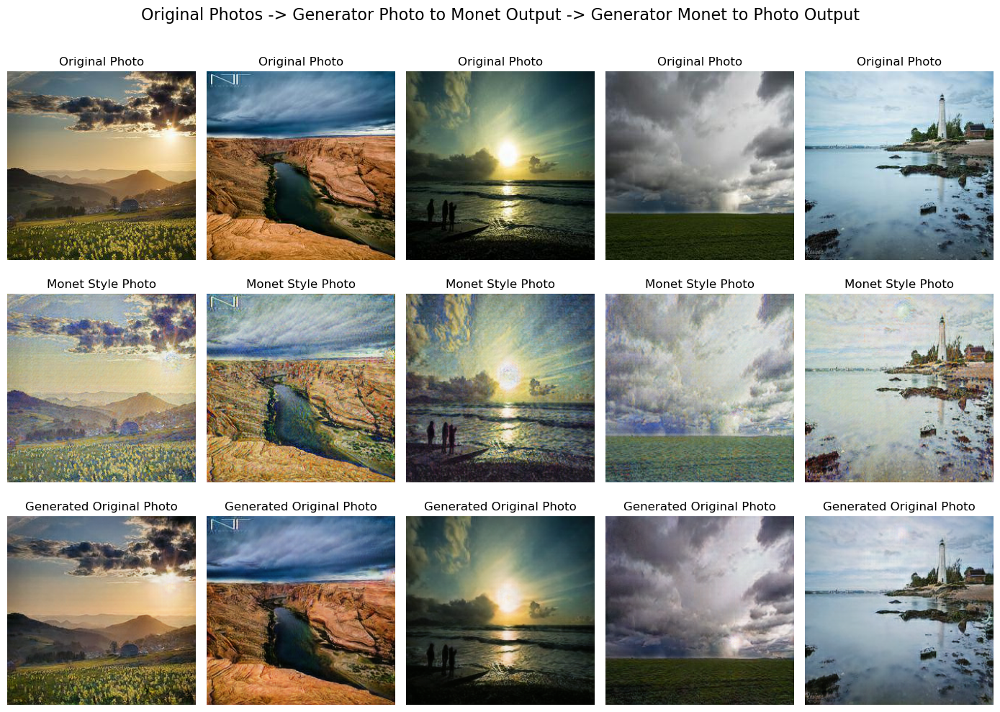

In [53]:
plt.figure(figsize=(14, 10))
plt.suptitle('Original Photos -> Generator Photo to Monet Output -> Generator Monet to Photo Output', y=1.01, fontsize=16)
for i in range(5):
    plt.subplot(3, 5, i+1)
    plt.imshow(original_imgs[i])
    plt.title('Original Photo')
    plt.axis('off')

for i in range(5):
    plt.subplot(3, 5, i+6)
    plt.imshow(preds_imgs[i])
    plt.title('Monet Style Photo')
    plt.axis('off')

for i in range(5):
    plt.subplot(3, 5, i+11)
    plt.imshow(back_to_original_imgs[i])
    plt.title('Generated Original Photo')
    plt.axis('off')

plt.tight_layout()

## 5. Conclusion and Take Away
As previously stated, this project largely implemented the CycleGAN framework proposed by Jun-Yan Zhu et al., utilizing their established hyperparameters. The code largely followed the Generative Adversarial Networks (GANs) Specialization Course from Deep Learning AI by Sharon Zhou. Nevertheless, observing the results is fascinating. The model learns and transfers complex textures, patterns, and stylistic features from one domain to another while preserving the semantic content of the original images.

What did and did not help improve the performance of your models?
* Longer training sessions  generally improved the performance.
* Introducing spatial transformations like flips and crops slightly improved model performance.
* An increase in generator loss was noticed after training for 95 epochs without additional Monet images, which may indicate a sign of overfitting or a mode collapse. Note: the original CycleGAN was trained on dataset consisting of approximately 2,000 images per domain.
* Training with additional Monet images from the Berkeley dataset along with introducing spatial transformations, helped improve performance and reduce checkerboard artifacts visually.
* Fine-tuning the pre-trained CycleGAN model, which was originally trained for horse-to-zebra style transfer, with our dataset resulted in improved performance on Kaggle compared to training from scratch for the same 100 epochs.

What improvements could you try in the future?
* Apply learning rate decay when fine-tuning a pre-trained model. The CycleGAN authors set a fixed learning for the first 100 epochs and linearly decay the rate to zero over the next 100 epochs. (I only remembered that I needed to decay my learning rate when using a pre-trained model after all the training was done).
* Explore multiple mappings between domains, perhaps allowing the model to learn multiple styles within each domain.

### References
* Jun-Yan Zhu, Taesung Park, Phillip Isola, Alexei A. Efros. [*Unpaired Image-to-Image Translation
using Cycle-Consistent Adversarial Networks*](https://arxiv.org/pdf/1703.10593)
* Sharon Zhou. [*Generative Adversarial Networks (GANs) Specialization on Coursera*](https://www.coursera.org/specializations/generative-adversarial-networks-gans)
* Amy Jang. [*Monet CycleGAN Tutorial on Kaggle*](https://www.kaggle.com/code/amyjang/monet-cyclegan-tutorial)
* Stackoverflow and PyTorch Documentation.

#### Run Generator over All Photos for Kaggle Submission

In [34]:
class PhotoDataset(Dataset):
    def __init__(self, photo_dir):
        super().__init__()
        self.photo_dir = photo_dir
        self.photo_idx = dict()
        self.transform = transforms.Compose([
            transforms.Resize((256, 256)),
            transforms.ToTensor(),
        ])
        for i, filename in enumerate(os.listdir(self.photo_dir)):
            self.photo_idx[i] = filename

    def __getitem__(self, idx):
        photo_path = os.path.join(self.photo_dir, self.photo_idx[idx])
        photo_img = Image.open(photo_path)
        photo_img = self.transform(photo_img)
        return (photo_img - 0.5) * 2

    def __len__(self):
        return len(self.photo_idx.keys())

In [43]:
def unnorm(img, mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]):
    for t, m, s in zip(img, mean, std):
        t.mul_(s).add_(s)        
    return img

In [36]:
photo_ds = PhotoDataset('../input/gan-getting-started/photo_jpg/')

photo_dl = DataLoader(photo_ds, batch_size=1, pin_memory=True)

In [39]:
os.makedirs('images')

In [41]:
transf = transforms.ToPILImage()

In [51]:
t = tqdm(photo_dl, leave=False, total=photo_dl.__len__())
for i, photo in enumerate(t):
    with torch.no_grad():
        predict_monet = gen_BA(photo.to(device)).cpu().detach()
    predict_monet = unnorm(predict_monet)
    img = transf(predict_monet[0]).convert('RGB')
    img.save('../images/' + str(i+1) + '.jpg')

  0%|          | 0/7038 [00:00<?, ?it/s]

In [53]:
import shutil

shutil.make_archive("/kaggle/working/images", 'zip', "/kaggle/images")